# Data loading

In [1]:
import numpy as np
import pandas as pd
import pickle
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.utils import shuffle
from sklearn.preprocessing import LabelEncoder, OrdinalEncoder
from sklearn.ensemble import RandomForestClassifier
import matplotlib.pyplot as plt
from dotenv import load_dotenv
import os
load_dotenv()

True

### Load training data

In [2]:
data_path = os.environ.get("DATA_PATH")
data = pd.read_csv(data_path+'/train.csv', sep=';')

### Load test data

In [13]:
data_test = pd.read_csv(data_path+'/test.csv', sep=';')
data_test.head(10)

,WELL,DEPTH_MD,X_LOC,Y_LOC,Z_LOC,GROUP,FORMATION,CALI,RSHA,RMED,...,SP,BS,ROP,DTS,DCAL,DRHO,MUDWEIGHT,RMIC,ROPA,RXO
0,15/9-14,480.628001,423244.50000,6461862.5,-455.624420,NORDLAND GP.,NaN,19.2031,NaN,1.613886,...,35.525719,NaN,96.461990,NaN,NaN,-0.538873,0.130611,NaN,NaN,NaN
1,15/9-14,480.780001,423244.50000,6461862.5,-455.776428,NORDLAND GP.,NaN,19.2031,NaN,1.574376,...,36.158520,NaN,96.454399,NaN,NaN,-0.539232,0.130611,NaN,NaN,NaN
2,15/9-14,480.932001,423244.50000,6461862.5,-455.928436,NORDLAND GP.,NaN,19.2031,NaN,1.436627,...,36.873703,NaN,96.446686,NaN,NaN,-0.540830,0.130611,NaN,NaN,NaN
3,15/9-14,481.084001,423244.50000,6461862.5,-456.080444,NORDLAND GP.,NaN,19.2031,NaN,1.276094,...,37.304054,NaN,161.170166,NaN,NaN,-0.543943,0.130611,NaN,NaN,NaN
4,15/9-14,481.236001,423244.53125,6461862.5,-456.232422,NORDLAND GP.,NaN,19.2031,NaN,1.204704,...,37.864922,NaN,172.489120,NaN,NaN,-0.542104,0.130611,NaN,NaN,NaN
5,15/9-14,481.388001,423244.53125,6461862.5,-456.384430,NORDLAND GP.,NaN,19.2031,NaN,1.241381,...,37.630371,NaN,172.343338,NaN,NaN,-0.539374,0.130611,NaN,NaN,NaN
6,15/9-14,481.540001,423244.53125,6461862.5,-456.536438,NORDLAND GP.,NaN,19.2031,NaN,1.358391,...,37.403320,NaN,172.197586,NaN,NaN,-0.533637,0.130611,NaN,NaN,NaN
7,15/9-14,481.692001,423244.53125,6461862.5,-456.688416,NORDLAND GP.,NaN,19.2031,NaN,1.478114,...,37.143818,NaN,172.051788,NaN,NaN,-0.527703,0.130611,NaN,NaN,NaN
8,15/9-14,481.844001,423244.53125,6461862.5,-456.840424,NORDLAND GP.,NaN,19.2031,NaN,1.532573,...,36.397198,NaN,171.906036,NaN,NaN,-0.522703,0.130611,NaN,NaN,NaN
9,15/9-14,481.996001,423244.53125,6461862.5,-456.992432,NORDLAND GP.,NaN,19.2031,NaN,1.531958,...,36.348286,NaN,171.594177,NaN,NaN,-0.521685,0.130611,NaN,NaN,NaN


In [63]:
data_test.columns

Index(['WELL', 'DEPTH_MD', 'X_LOC', 'Y_LOC', 'Z_LOC', 'GROUP', 'FORMATION',
       'CALI', 'RSHA', 'RMED', 'RDEP', 'RHOB', 'GR', 'SGR', 'NPHI', 'PEF',
       'DTC', 'SP', 'BS', 'ROP', 'DTS', 'DCAL', 'DRHO', 'MUDWEIGHT', 'RMIC',
       'ROPA', 'RXO'],
      dtype='object')

# Data completeness

### Based on the following [notebook](https://nbviewer.jupyter.org/github/mycarta/Force-2020-Machine-Learning-competition_predict-lithology-EDA/blob/master/data_completeness_visualization.ipynb)

In [3]:
import pandas as pd
import missingno as msno
import matplotlib.pyplot as plt

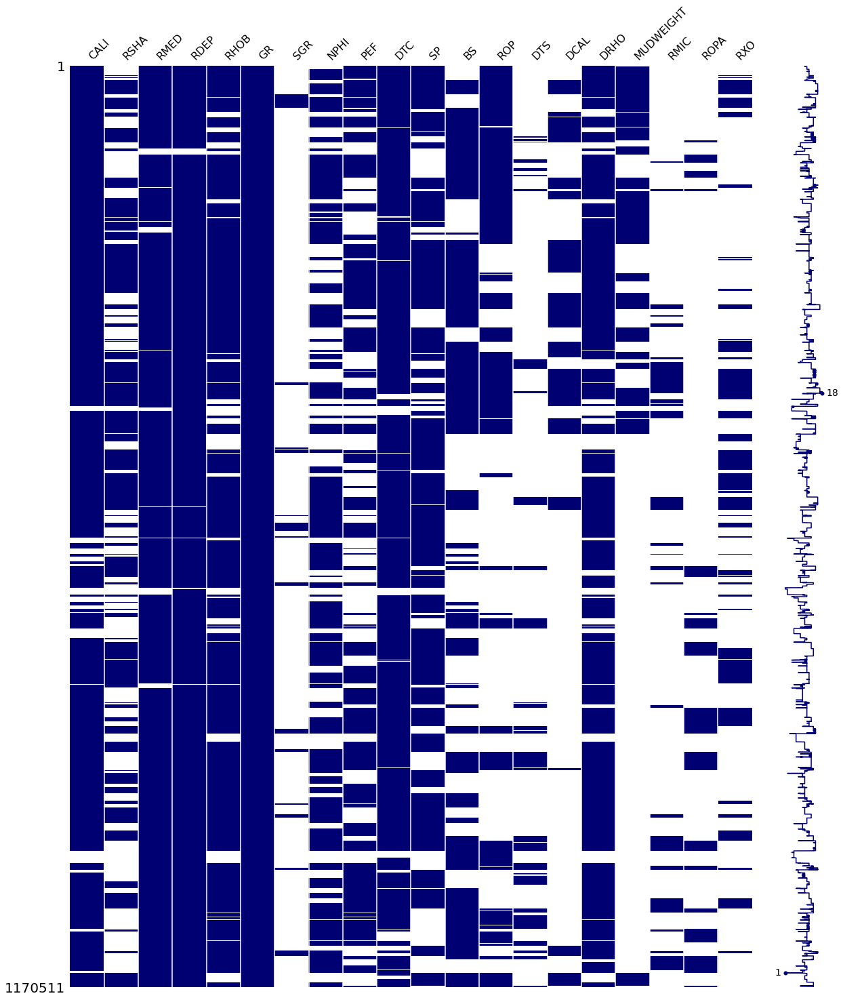

In [4]:
w = data.drop(['WELL', 'DEPTH_MD','X_LOC','Y_LOC','Z_LOC','GROUP','FORMATION',
                       'FORCE_2020_LITHOFACIES_LITHOLOGY','FORCE_2020_LITHOFACIES_CONFIDENCE'], 
                      axis=1)
msno.matrix(w, color=(0., 0., 0.45))
fig = plt.gcf()
fig.set_size_inches(20, 25)
plt.show() 

<AxesSubplot:>

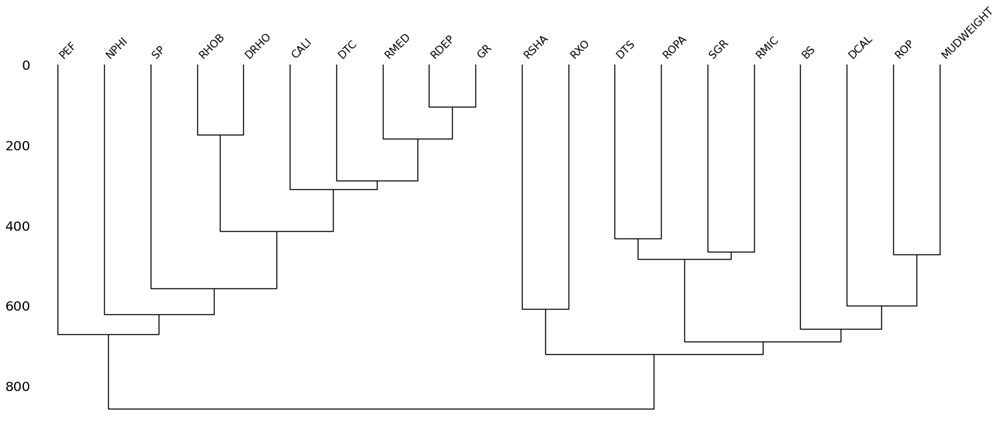

In [11]:
msno.dendrogram(data.drop(['WELL', 'DEPTH_MD','X_LOC','Y_LOC','Z_LOC','GROUP','FORMATION',
                         'FORCE_2020_LITHOFACIES_LITHOLOGY','FORCE_2020_LITHOFACIES_CONFIDENCE'], axis=1))

# Data Visualization

### Based on the following [notebook](https://nbviewer.jupyter.org/urls/gitlab.com/hilde.tveit.haland/public-notebooks/-/raw/master/Force%202020-%20CegalWells%20EDA.ipynb)

In [15]:
import plotly.express as px
fig = px.histogram(data.dropna(subset=['FORCE_2020_LITHOFACIES_CONFIDENCE']), 
                                x='FORCE_2020_LITHOFACIES_CONFIDENCE', 
                                color='FORCE_2020_LITHOFACIES_CONFIDENCE')
fig.update_layout(title='Distribution of lithofacies confidence in training dataset')
fig.show()

In [16]:
from cegaltools.plotting import CegalWellPlotter as cwp

In [17]:
data['FORCE_2020_LITHOFACIES_CONFIDENCE'] = 1/data['FORCE_2020_LITHOFACIES_CONFIDENCE']

In [18]:
df = data.loc[data.WELL == data.WELL.unique()[10]].set_index('DEPTH_MD')

In [19]:
cwp.plot_logs(df=df, 
              logs=['GROUP','FORMATION', 'RHOB', 'GR', 'NPHI', 'DTC', 'DTS'], 
              log_scale_logs=['RMED', 'RDEP'],
              lithology_logs='FORCE_2020_LITHOFACIES_LITHOLOGY', 
              lithology_proba_logs='FORCE_2020_LITHOFACIES_CONFIDENCE')

## Correlation plot

In [20]:
cwp.plot_correlation(df=df)

## Coverage plot

In [21]:
cwp.plot_coverage(df=df)